### Part 01. Load packages and libs

In [1]:
import warnings
import os
import time
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models
from torch.utils.data import Dataset, DataLoader

from tqdm import tqdm
import albumentations as A
from albumentations.pytorch import ToTensorV2

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

warnings.filterwarnings("ignore")

c:\Users\minht\anaconda3\envs\pydl\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Part 02. Writing a custom dataset for Blood Cell Segmemtation dataset, write data loader to load data for train model

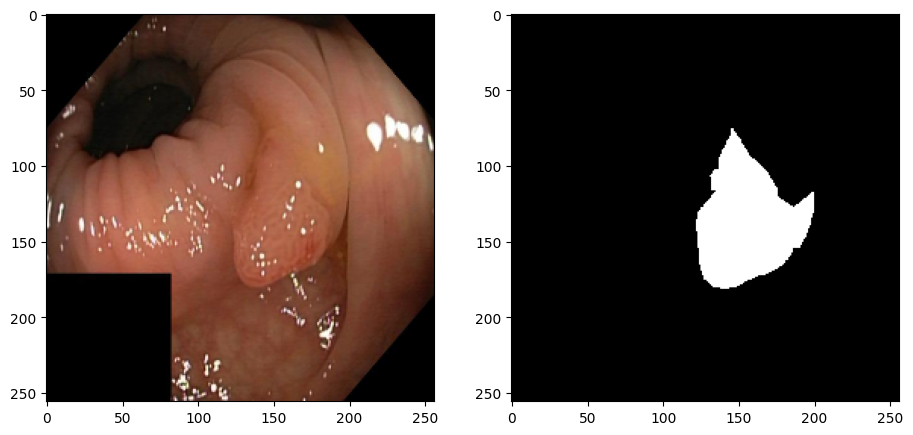

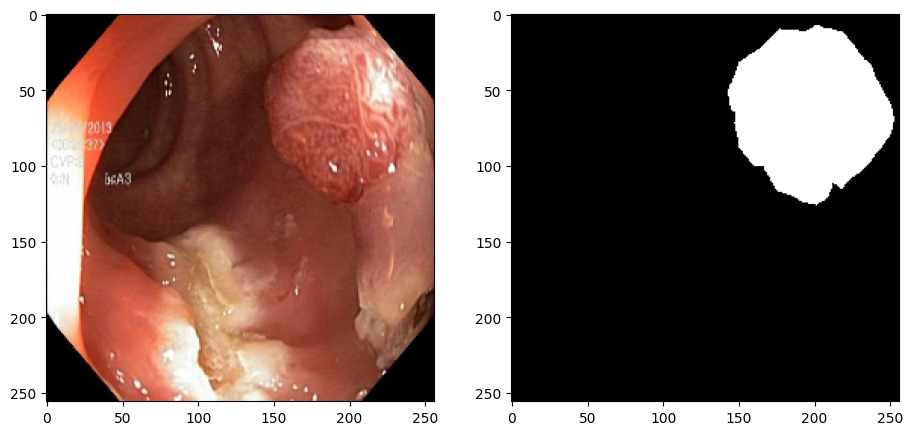

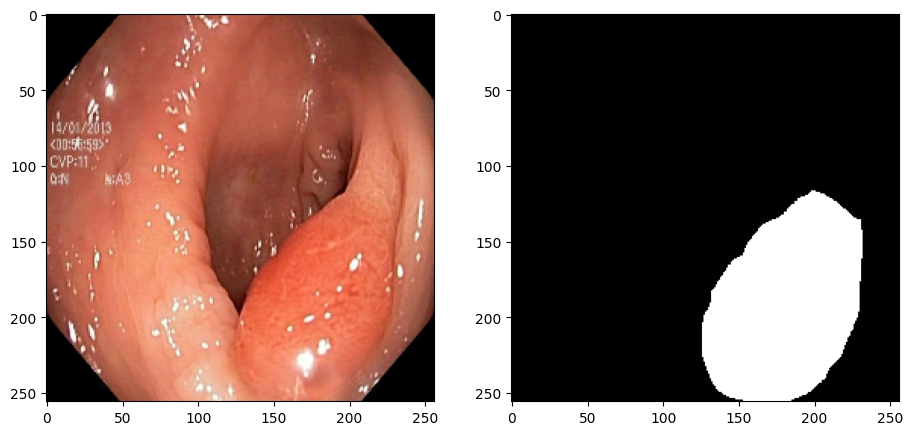

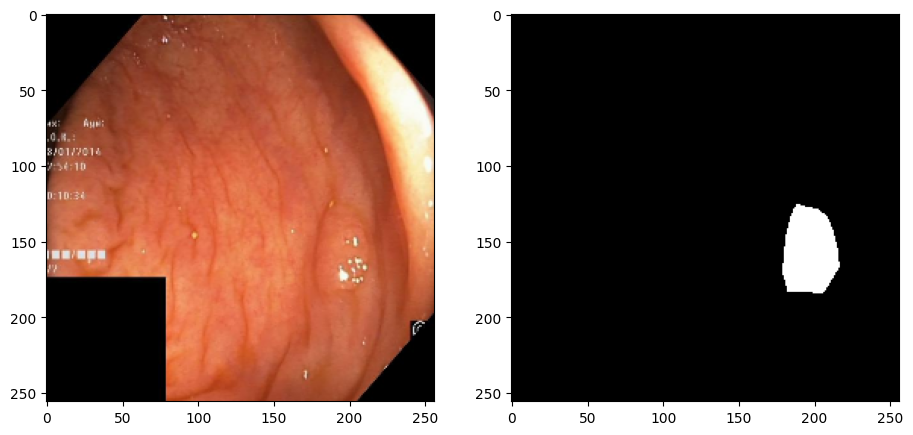

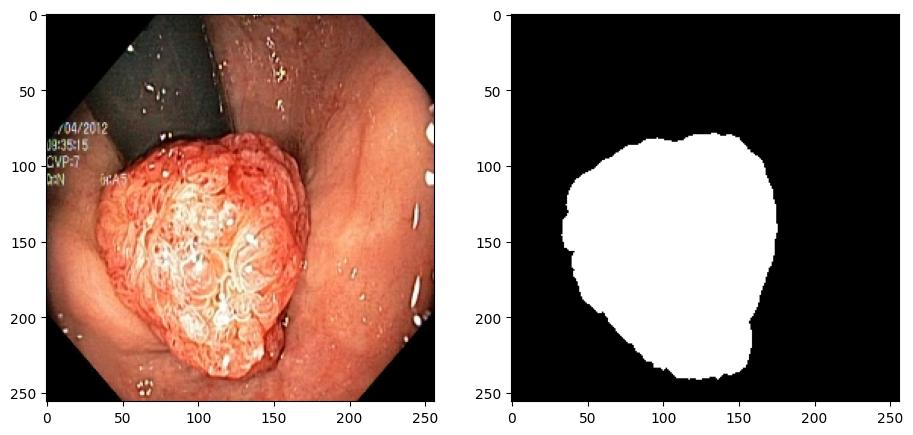

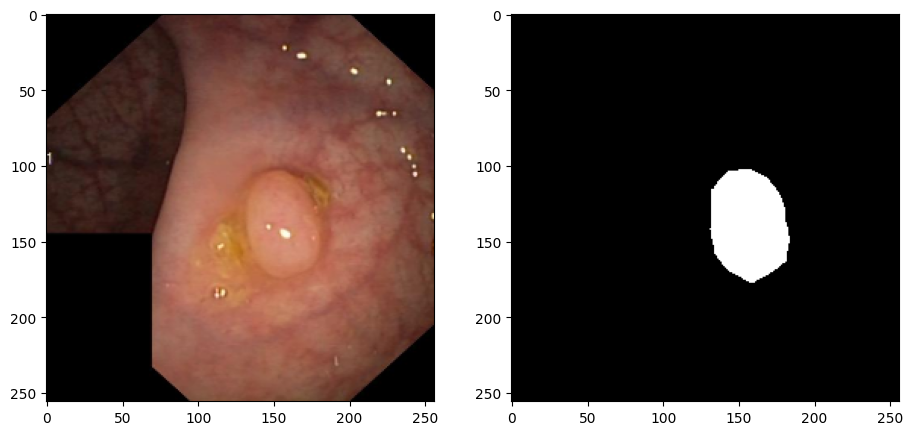

In [2]:
TRAIN_IMG_DIR = "datasets/kvasir_v1/train/images"
TRAIN_MASK_DIR = "datasets/kvasir_v1/train/masks"
VAL_IMG_DIR = "datasets/kvasir_v1/test/images"
VAL_MASK_DIR = "datasets/kvasir_v1/test/masks"


class BloodCellDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None) -> None:
        super(BloodCellDataset, self).__init__()
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        image_path = os.path.join(self.image_dir, self.images[index])
        mask_path = os.path.join(
            self.mask_dir, self.images[index])

        image = np.array(Image.open(image_path).convert("RGB"))
        mask = np.array(Image.open(mask_path).convert("L"),
                        dtype=np.float32)
        # mask[mask == 255.0] = 1.0
        mask = np.where(mask > 155.0, 1.0, 0.0)

        if self.transform is not None:
            augemantations = self.transform(image=image, mask=mask)
            image = augemantations['image']
            mask = augemantations['mask']
        return image, mask

def get_data_loaders(
        train_dir, train_mask_dir, val_dir, val_maskdir, batch_size,
        train_transform, val_transform):

    train_ds = BloodCellDataset(
        image_dir=train_dir, mask_dir=train_mask_dir,
        transform=train_transform)

    train_loader = DataLoader(
        train_ds,
        batch_size=batch_size,
        shuffle=True,
    )

    val_ds = BloodCellDataset(
        image_dir=val_dir,
        mask_dir=val_maskdir,
        transform=val_transform,
    )

    val_loader = DataLoader(
        val_ds,
        batch_size=batch_size,
        shuffle=False,
    )

    return train_loader, val_loader

train_transform = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

BATCH_SIZE = 6
train_loader, val_loader = get_data_loaders(
    TRAIN_IMG_DIR,
    TRAIN_MASK_DIR,
    VAL_IMG_DIR,
    VAL_MASK_DIR,
    BATCH_SIZE,
    train_transform,
    val_transforms
)

def show_transformed(data_loader):
    batch = next(iter(data_loader))
    images, labels = batch

    for img, mask in zip(images, labels):
        plt.figure(figsize=(11, 11))

        plt.subplot(1, 2, 1)
        plt.imshow(np.transpose(img, (1, 2, 0)))

        plt.subplot(1, 2, 2)
        # plt.imshow(mask.reshape(mask.shape[0], mask.shape[1], 1))
        plt.imshow(mask, cmap="gray")


show_transformed(val_loader)

### Part 03. Implement the deeplabv3+ model from scratch with pytorch

In [3]:
class ResNet_50(nn.Module):
    def __init__(self, output_layer=None):
        super(ResNet_50, self).__init__()
        self.pretrained = models.resnet50(pretrained=True)
        self.output_layer = output_layer

        self.layers = []
        for name, module in self.pretrained.named_children():
            self.layers.append((name, module))
            if name == self.output_layer:
                break

        self.net = nn.Sequential(*[module for _, module in self.layers])

    def forward(self, x):
        return self.net(x)

class Atrous_Convolution(nn.Module):
    def __init__(
            self, input_channels, kernel_size, pad, dilation_rate,
            output_channels=256):
        super(Atrous_Convolution, self).__init__()

        self.conv = nn.Conv2d(in_channels=input_channels,
                              out_channels=output_channels,
                              kernel_size=kernel_size, padding=pad,
                              dilation=dilation_rate, bias=False)

        self.batchnorm = nn.BatchNorm2d(output_channels)

        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):

        x = self.conv(x)
        x = self.batchnorm(x)
        x = self.relu(x)
        return x

class Atrous_Spatial_Pyramid_Pooling(nn.Module):
    def __init__(self, in_channles, out_channles):
        super(Atrous_Spatial_Pyramid_Pooling, self).__init__()
        self.conv_1x1 = Atrous_Convolution(
            input_channels=in_channles, output_channels=out_channles,
            kernel_size=1, pad=0, dilation_rate=1)

        self.conv_3x3_r6 = Atrous_Convolution(
            input_channels=in_channles, output_channels=out_channles,
            kernel_size=3, pad=6, dilation_rate=6)

        self.conv_3x3_r12 = Atrous_Convolution(
            input_channels=in_channles, output_channels=out_channles,
            kernel_size=3, pad=12, dilation_rate=12)

        self.conv_3x3_r18 = Atrous_Convolution(
            input_channels=in_channles, output_channels=out_channles,
            kernel_size=3, pad=18, dilation_rate=18)

        self.image_pool = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(
                in_channels=in_channles, out_channels=out_channles,
                kernel_size=1, stride=1, padding=0, dilation=1, bias=False),
            nn.LayerNorm([out_channles, 1, 1]),
            # nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )

        self.final_conv = Atrous_Convolution(
            input_channels=out_channles * 5, output_channels=out_channles,
            kernel_size=1, pad=0, dilation_rate=1)

    def forward(self, x):
        x_1x1 = self.conv_1x1(x)
        x_3x3_r6 = self.conv_3x3_r6(x)
        x_3x3_r12 = self.conv_3x3_r12(x)
        x_3x3_r18 = self.conv_3x3_r18(x)
        img_pool_opt = self.image_pool(x)
        img_pool_opt = F.interpolate(
            img_pool_opt, size=x_3x3_r18.size()[2:],
            mode='bilinear', align_corners=True)
        concat = torch.cat(
            (x_1x1, x_3x3_r6, x_3x3_r12, x_3x3_r18, img_pool_opt),
            dim=1)
        x_final_conv = self.final_conv(concat)
        return x_final_conv

class Deeplabv3Plus(nn.Module):
    def __init__(self, num_classes):
        super(Deeplabv3Plus, self).__init__()
        self.backbone = ResNet_50(output_layer='layer3')
        self.low_level_features = ResNet_50(output_layer='layer1')

        self.aspp = Atrous_Spatial_Pyramid_Pooling(
            in_channles=1024, out_channles=256)

        self.conv1x1 = Atrous_Convolution(
            input_channels=256, output_channels=48, kernel_size=1,
            dilation_rate=1, pad=0)

        self.conv_3x3 = nn.Sequential(
            nn.Conv2d(304, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )

        self.classifer = nn.Conv2d(256, num_classes, 1)

    def forward(self, x):
        x_backbone = self.backbone(x)
        x_low_level = self.low_level_features(x)
        x_aspp = self.aspp(x_backbone)
        x_aspp_upsampled = F.interpolate(
            x_aspp, scale_factor=(4, 4),
            mode='bilinear', align_corners=True)
        x_conv1x1 = self.conv1x1(x_low_level)
        x_cat = torch.cat([x_conv1x1, x_aspp_upsampled], dim=1)
        x_3x3 = self.conv_3x3(x_cat)
        x_3x3_upscaled = F.interpolate(
            x_3x3, scale_factor=(4, 4),
            mode='bilinear', align_corners=True)
        x_out = self.classifer(x_3x3_upscaled)
        return x_out

### Part 04. Define the Dice loss func and IoU func because we are implementing from scratch

In [4]:
class DiceBCELoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceBCELoss, self).__init__()
        self.bce_losss = nn.BCEWithLogitsLoss()

    def forward(self, inputs, targets, smooth=1):
        BCE = self.bce_losss(inputs, targets)
        inputs = torch.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        dice_loss = 1 - (2.*intersection + smooth)/(
            inputs.sum() + targets.sum() + smooth)
        Dice_BCE = BCE + dice_loss
        return Dice_BCE


class IOU(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(IOU, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        inputs = torch.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        total = (inputs + targets).sum()
        union = total - intersection

        IoU = (intersection + smooth)/(union + smooth)
        return IoU

### Part 05. Define some hyper-parameters and vars to prepare for train the model

In [5]:
model = Deeplabv3Plus(num_classes=1).to(DEVICE)
loss_fn = DiceBCELoss()

iou_fn = IOU()
scaler = torch.cuda.amp.GradScaler()
LEARNING_RATE = 1e-4
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

train_iou = []
train_dice = []
train_loss = []

def save_checkpoint(state, filename="model.pth.tar"):
    print("=> Saving checkpoint")
    # torch.save(state, filename)

In [6]:
model

Deeplabv3Plus(
  (backbone): ResNet_50(
    (pretrained): ResNet(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): R

In [7]:
print(model)

Deeplabv3Plus(
  (backbone): ResNet_50(
    (pretrained): ResNet(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): R

### Part 06. Start training model trained

In [8]:
start_time = time.time()

# let's train it just for 2 epochs
NUM_EPOCHS = 22

for epoch in range(NUM_EPOCHS):
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}")

    iterations = 0
    iter_loss = 0.0
    iter_iou = 0.0

    batch_loop = tqdm(train_loader)
    for batch_idx, (data, targets) in enumerate(batch_loop):

        data = data.to(device=DEVICE)
        targets = targets.float().unsqueeze(1).to(device=DEVICE)

        with torch.cuda.amp.autocast():
            predictions = model(data)
            loss = loss_fn(predictions, targets)
            iou = iou_fn(predictions, targets)

            iter_loss += loss.item()
            iter_iou += iou.item()

        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        iterations += 1
        batch_loop.set_postfix(diceloss=loss.item(), iou=iou.item())

    train_loss.append(iter_loss / iterations)
    train_iou.append(iter_iou / iterations)
    # print(
    #     f"Epoch: {epoch+1}/{NUM_EPOCHS}, Training loss: {round(train_loss[-1] , 3)}")
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}, IoU score: {iter_iou / iterations}")

    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict()
    }
    # save_checkpoint(checkpoint)

    num_correct = 0
    num_pixels = 0
    dice_score = 0
    model.eval()

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(DEVICE)
            y = y.to(DEVICE).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds = (preds > 0.5).float()
            num_correct += (preds == y).sum()
            num_pixels += torch.numel(preds)
            dice_score += (2 * (preds * y).sum()) / (
                (preds + y).sum() + 1e-8
            )

    # print(
    #     f"Got {num_correct}/{num_pixels} with acc {num_correct/num_pixels*100:.2f}"
    # )
    print(
        f"Epoch: {epoch+1}/{NUM_EPOCHS}, Total num_correct/num_pixels: {num_correct}/{num_pixels} => {num_correct/num_pixels}"
    )
    print(
        f"Epoch: {epoch+1}/{NUM_EPOCHS}, Dice score: {dice_score / len(val_loader)}")
    train_dice.append(dice_score / len(val_loader))
    model.train()

print("done ..")

end_time = time.time()
training_time = end_time - start_time
print(
    f"The training time of the DeepLabv3+ model is: {training_time:.2f} seconds")

Epoch: 1/22


100%|██████████| 134/134 [18:58<00:00,  8.50s/it, diceloss=0.464, iou=0.487]


Epoch: 1/22, IoU score: 0.4740832945081725
Epoch: 1/22, Total num_correct/num_pixels: 12459150/13107200 => 0.9505577087402344
Epoch: 1/22, Dice score: 0.8264848670057543
Epoch: 2/22


100%|██████████| 134/134 [21:24<00:00,  9.59s/it, diceloss=0.185, iou=0.759]


Epoch: 2/22, IoU score: 0.6729360709884273
Epoch: 2/22, Total num_correct/num_pixels: 12502244/13107200 => 0.9538455009460449
Epoch: 2/22, Dice score: 0.8353946999831506
Epoch: 3/22


100%|██████████| 134/134 [18:23<00:00,  8.23s/it, diceloss=0.269, iou=0.658]


Epoch: 3/22, IoU score: 0.7722114048787018
Epoch: 3/22, Total num_correct/num_pixels: 12439533/13107200 => 0.9490610361099243
Epoch: 3/22, Dice score: 0.8334198611869552
Epoch: 4/22


100%|██████████| 134/134 [18:18<00:00,  8.20s/it, diceloss=0.0958, iou=0.88] 


Epoch: 4/22, IoU score: 0.824202898722976
Epoch: 4/22, Total num_correct/num_pixels: 12599577/13107200 => 0.9612714648246765
Epoch: 4/22, Dice score: 0.8576553535590312
Epoch: 5/22


100%|██████████| 134/134 [20:43<00:00,  9.28s/it, diceloss=0.0841, iou=0.911]


Epoch: 5/22, IoU score: 0.872164053703422
Epoch: 5/22, Total num_correct/num_pixels: 12581176/13107200 => 0.959867537021637
Epoch: 5/22, Dice score: 0.8464836842900106
Epoch: 6/22


100%|██████████| 134/134 [20:41<00:00,  9.26s/it, diceloss=0.0722, iou=0.922]


Epoch: 6/22, IoU score: 0.8839593027065049
Epoch: 6/22, Total num_correct/num_pixels: 12621012/13107200 => 0.9629067778587341
Epoch: 6/22, Dice score: 0.8686159664381318
Epoch: 7/22


100%|██████████| 134/134 [20:54<00:00,  9.36s/it, diceloss=0.165, iou=0.762] 


Epoch: 7/22, IoU score: 0.8947065819555254
Epoch: 7/22, Total num_correct/num_pixels: 12638356/13107200 => 0.9642300605773926
Epoch: 7/22, Dice score: 0.8644592372183836
Epoch: 8/22


100%|██████████| 134/134 [37:04<00:00, 16.60s/it, diceloss=0.0731, iou=0.885]


Epoch: 8/22, IoU score: 0.9123112190125594
Epoch: 8/22, Total num_correct/num_pixels: 12657963/13107200 => 0.9657259583473206
Epoch: 8/22, Dice score: 0.8745498647258048
Epoch: 9/22


100%|██████████| 134/134 [19:09<00:00,  8.58s/it, diceloss=0.0474, iou=0.949]


Epoch: 9/22, IoU score: 0.9304581137735453
Epoch: 9/22, Total num_correct/num_pixels: 12659704/13107200 => 0.9658587574958801
Epoch: 9/22, Dice score: 0.8744812351229516
Epoch: 10/22


100%|██████████| 134/134 [19:33<00:00,  8.76s/it, diceloss=0.0373, iou=0.951]


Epoch: 10/22, IoU score: 0.940946952620549
Epoch: 10/22, Total num_correct/num_pixels: 12672901/13107200 => 0.966865599155426
Epoch: 10/22, Dice score: 0.8754568108852722
Epoch: 11/22


100%|██████████| 134/134 [19:09<00:00,  8.58s/it, diceloss=0.0694, iou=0.928]


Epoch: 11/22, IoU score: 0.9444670908486665
Epoch: 11/22, Total num_correct/num_pixels: 12640616/13107200 => 0.964402437210083
Epoch: 11/22, Dice score: 0.8655632316333473
Epoch: 12/22


100%|██████████| 134/134 [15:56<00:00,  7.14s/it, diceloss=0.0347, iou=0.953]


Epoch: 12/22, IoU score: 0.9419495725809638
Epoch: 12/22, Total num_correct/num_pixels: 12636375/13107200 => 0.9640789031982422
Epoch: 12/22, Dice score: 0.8676521973630037
Epoch: 13/22


100%|██████████| 134/134 [13:04<00:00,  5.85s/it, diceloss=0.0556, iou=0.92] 


Epoch: 13/22, IoU score: 0.949456272285376
Epoch: 13/22, Total num_correct/num_pixels: 12642349/13107200 => 0.9645346999168396
Epoch: 13/22, Dice score: 0.8721315594455644
Epoch: 14/22


100%|██████████| 134/134 [12:33<00:00,  5.62s/it, diceloss=0.0315, iou=0.956]


Epoch: 14/22, IoU score: 0.9551808678392154
Epoch: 14/22, Total num_correct/num_pixels: 12659134/13107200 => 0.9658153057098389
Epoch: 14/22, Dice score: 0.8718642882462575
Epoch: 15/22


100%|██████████| 134/134 [12:33<00:00,  5.62s/it, diceloss=0.0313, iou=0.958]


Epoch: 15/22, IoU score: 0.9586810834372221
Epoch: 15/22, Total num_correct/num_pixels: 12664769/13107200 => 0.966245174407959
Epoch: 15/22, Dice score: 0.8746199926633402
Epoch: 16/22


100%|██████████| 134/134 [09:43<00:00,  4.35s/it, diceloss=0.0484, iou=0.934]


Epoch: 16/22, IoU score: 0.9556535593609312
Epoch: 16/22, Total num_correct/num_pixels: 12634067/13107200 => 0.9639028310775757
Epoch: 16/22, Dice score: 0.8700272359707624
Epoch: 17/22


100%|██████████| 134/134 [13:03<00:00,  5.84s/it, diceloss=0.0739, iou=0.924]


Epoch: 17/22, IoU score: 0.9421666393529123
Epoch: 17/22, Total num_correct/num_pixels: 12279179/13107200 => 0.9368270039558411
Epoch: 17/22, Dice score: 0.7975605553388899
Epoch: 18/22


100%|██████████| 134/134 [12:40<00:00,  5.68s/it, diceloss=0.352, iou=0.558] 


Epoch: 18/22, IoU score: 0.8304528420540824
Epoch: 18/22, Total num_correct/num_pixels: 12514599/13107200 => 0.9547881484031677
Epoch: 18/22, Dice score: 0.8404994160131636
Epoch: 19/22


100%|██████████| 134/134 [12:30<00:00,  5.60s/it, diceloss=0.206, iou=0.83]  


Epoch: 19/22, IoU score: 0.9030808615150736
Epoch: 19/22, Total num_correct/num_pixels: 12638244/13107200 => 0.9642214775085449
Epoch: 19/22, Dice score: 0.867965010265619
Epoch: 20/22


100%|██████████| 134/134 [13:10<00:00,  5.90s/it, diceloss=0.0787, iou=0.917]


Epoch: 20/22, IoU score: 0.942542750888796
Epoch: 20/22, Total num_correct/num_pixels: 12658064/13107200 => 0.9657336473464966
Epoch: 20/22, Dice score: 0.871229620154296
Epoch: 21/22


100%|██████████| 134/134 [13:06<00:00,  5.87s/it, diceloss=0.041, iou=0.94]  


Epoch: 21/22, IoU score: 0.9524436059282787
Epoch: 21/22, Total num_correct/num_pixels: 12681576/13107200 => 0.967527449131012
Epoch: 21/22, Dice score: 0.8790121190285608
Epoch: 22/22


100%|██████████| 134/134 [13:28<00:00,  6.04s/it, diceloss=0.0387, iou=0.945]


Epoch: 22/22, IoU score: 0.9600332285930862
Epoch: 22/22, Total num_correct/num_pixels: 12672196/13107200 => 0.9668118357658386
Epoch: 22/22, Dice score: 0.878341697393567
done ..
The training time of the DeepLabv3+ model is: 24286.42 seconds


### Part 07. Visualize the training process and test the model trained

In [9]:
print(train_loss)

[0.5902811155390384, 0.3041651804945362, 0.19783832399702783, 0.14880525520933208, 0.10511909403018098, 0.09440712786432523, 0.08646058338457968, 0.07070999648143995, 0.05489236005206606, 0.04617688938308118, 0.04332257587629468, 0.045860523997402904, 0.039931087073550295, 0.03508858990146598, 0.03213664858754891, 0.034762274640709606, 0.04829895589500666, 0.16643319390158154, 0.08722868764689609, 0.04742580377010267, 0.03818757152323848, 0.03167718370903784]


In [10]:
print(train_iou)

[0.4740832945081725, 0.6729360709884273, 0.7722114048787018, 0.824202898722976, 0.872164053703422, 0.8839593027065049, 0.8947065819555254, 0.9123112190125594, 0.9304581137735453, 0.940946952620549, 0.9444670908486665, 0.9419495725809638, 0.949456272285376, 0.9551808678392154, 0.9586810834372221, 0.9556535593609312, 0.9421666393529123, 0.8304528420540824, 0.9030808615150736, 0.942542750888796, 0.9524436059282787, 0.9600332285930862]


In [11]:
print(train_dice)

[tensor(0.8265, dtype=torch.float64), tensor(0.8354, dtype=torch.float64), tensor(0.8334, dtype=torch.float64), tensor(0.8577, dtype=torch.float64), tensor(0.8465, dtype=torch.float64), tensor(0.8686, dtype=torch.float64), tensor(0.8645, dtype=torch.float64), tensor(0.8745, dtype=torch.float64), tensor(0.8745, dtype=torch.float64), tensor(0.8755, dtype=torch.float64), tensor(0.8656, dtype=torch.float64), tensor(0.8677, dtype=torch.float64), tensor(0.8721, dtype=torch.float64), tensor(0.8719, dtype=torch.float64), tensor(0.8746, dtype=torch.float64), tensor(0.8700, dtype=torch.float64), tensor(0.7976, dtype=torch.float64), tensor(0.8405, dtype=torch.float64), tensor(0.8680, dtype=torch.float64), tensor(0.8712, dtype=torch.float64), tensor(0.8790, dtype=torch.float64), tensor(0.8783, dtype=torch.float64)]


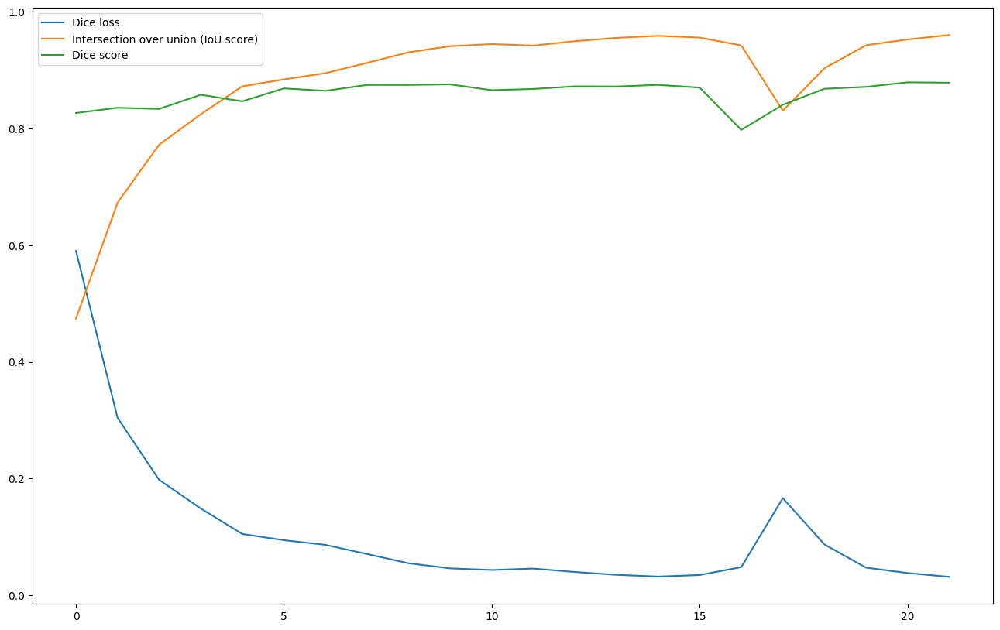

In [12]:
f = plt.figure(figsize=(16, 10))
plt.plot(train_loss, label='Dice loss')
plt.plot(train_iou, label='Intersection over union (IoU score)')
plt.plot(train_dice, label='Dice score')
plt.legend()
plt.show()

In [13]:
def test_model(model, val_loader, device):
    model.eval()
    dice_score = 0
    iou_metric = IOU()
    iou_score = 0

    with torch.no_grad():
        for x, y in tqdm(val_loader, desc="Testing"):
            x = x.to(device)
            y = y.to(device).unsqueeze(1)

            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            dice_score += (2 * (preds_binary * y).sum()) / (
                (preds_binary + y).sum() + 1e-8
            )
            iou_score += iou_metric(preds_binary, y)

    avg_dice = dice_score / len(val_loader)
    avg_iou = iou_score / len(val_loader)

    print(f"Average Dice Score: {avg_dice:.4f}")
    print(f"Average IoU Score: {avg_iou:.4f}")

    return avg_dice, avg_iou


avg_dice, avg_iou = test_model(model, val_loader, DEVICE)

Testing: 100%|██████████| 34/34 [01:00<00:00,  1.77s/it]

Average Dice Score: 0.8783
Average IoU Score: 0.1749


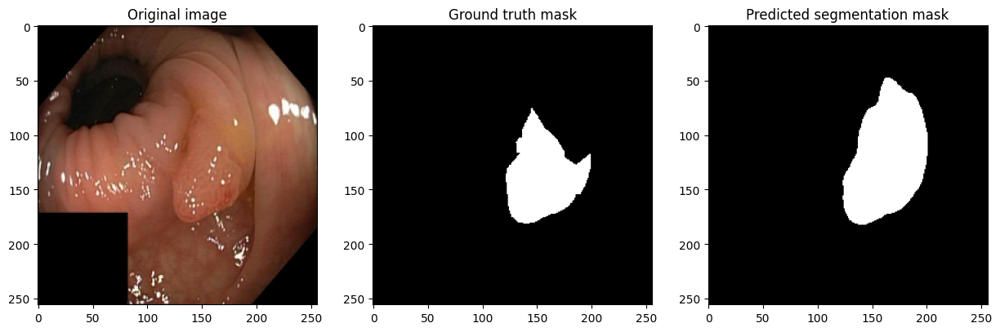

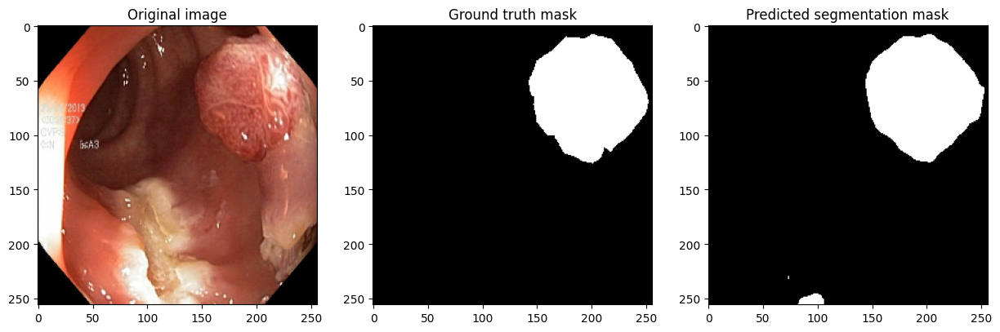

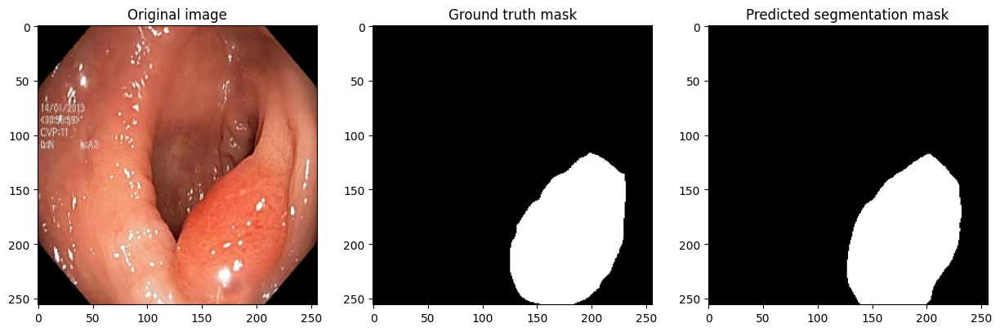

In [14]:
def visualize_predictions(model, val_loader, device, num_samples=3):
    model.eval()
    samples = 0

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(device)
            y = y.to(device).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            for i in range(x.size(0)):
                if samples >= num_samples:
                    break

                plt.figure(figsize=(15, 5))

                plt.subplot(1, 3, 1)
                plt.title("Original image")
                plt.imshow(np.transpose(x[i].cpu().numpy(), (1, 2, 0)))

                plt.subplot(1, 3, 2)
                plt.title("Ground truth mask")
                plt.imshow(y[i].cpu().numpy().squeeze(), cmap="gray")

                plt.subplot(1, 3, 3)
                plt.title("Predicted segmentation mask")
                plt.imshow(preds_binary[i].cpu(
                ).numpy().squeeze(), cmap="gray")

                plt.show()
                samples += 1

            if samples >= num_samples:
                break

visualize_predictions(model, val_loader, DEVICE)

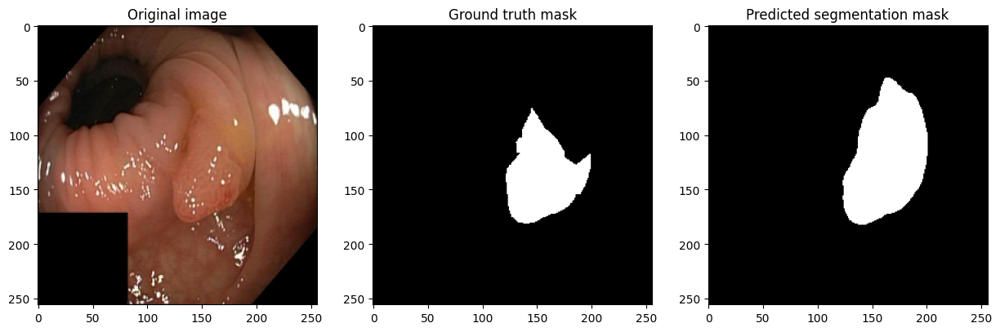

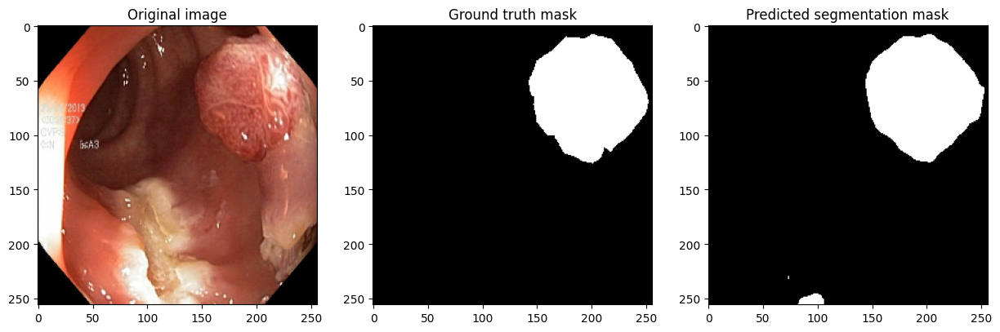

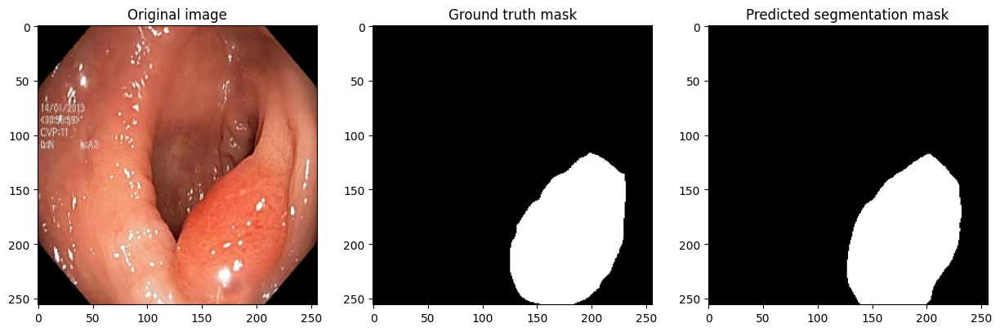

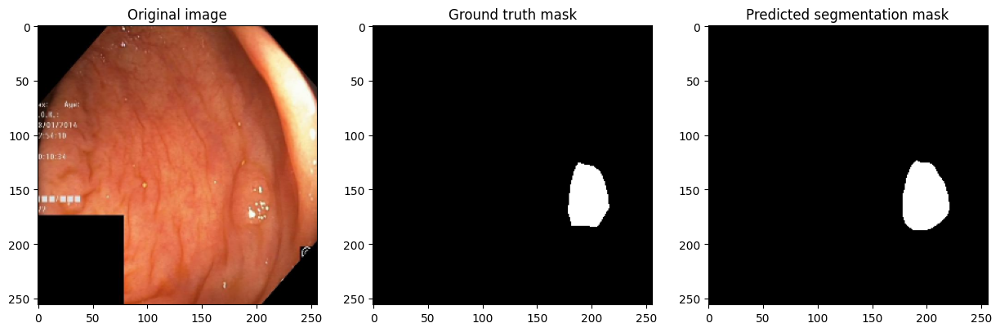

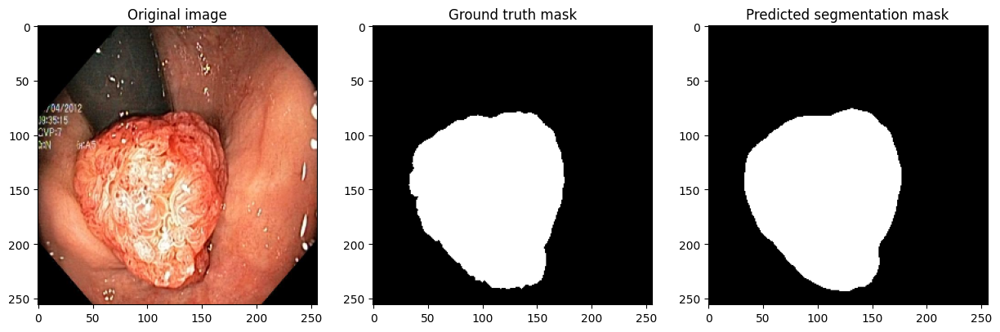

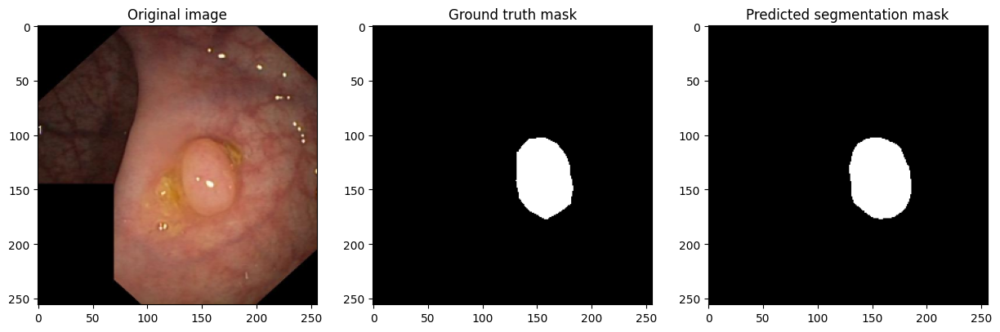

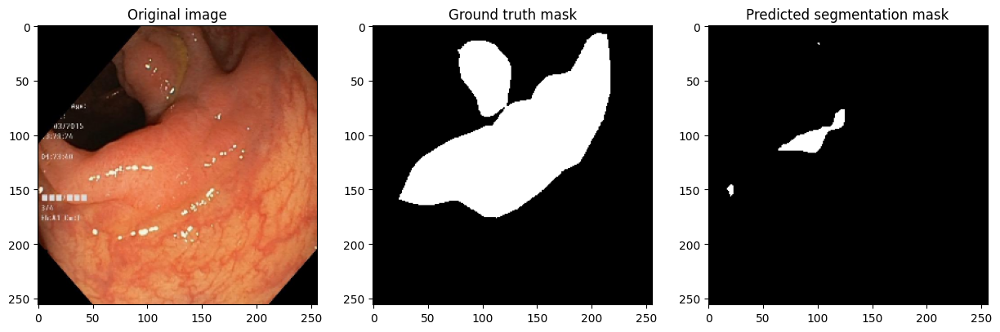

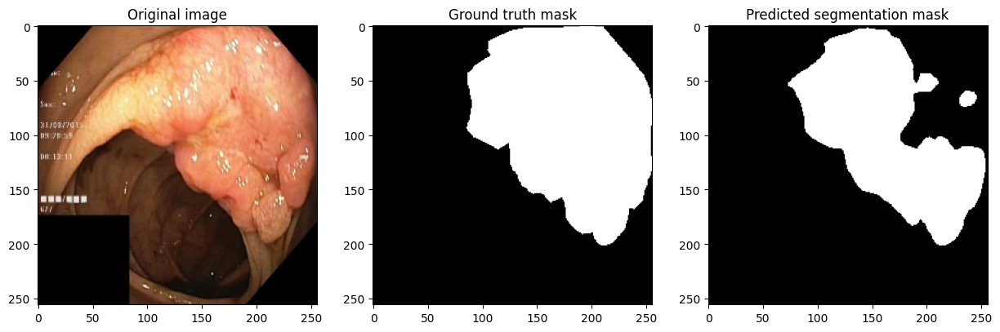

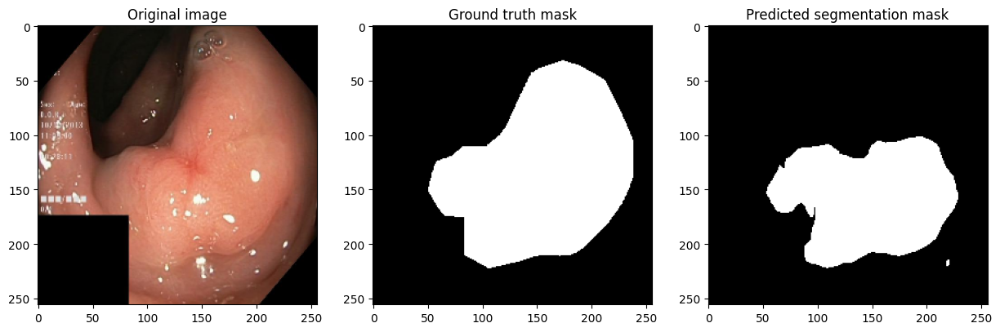

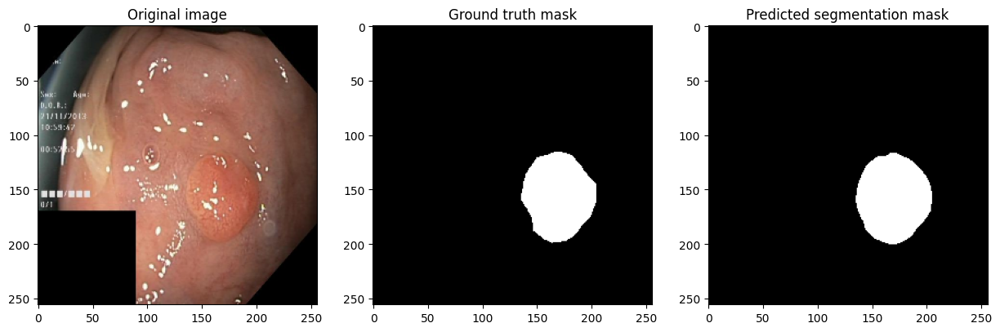

In [15]:
visualize_predictions(model, val_loader, DEVICE, num_samples=10)

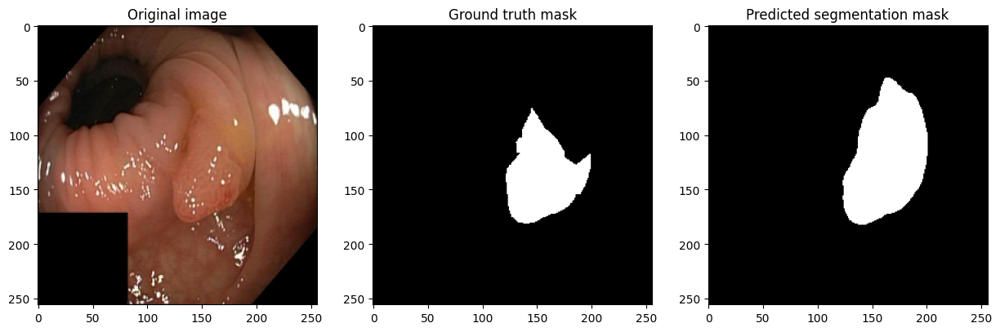

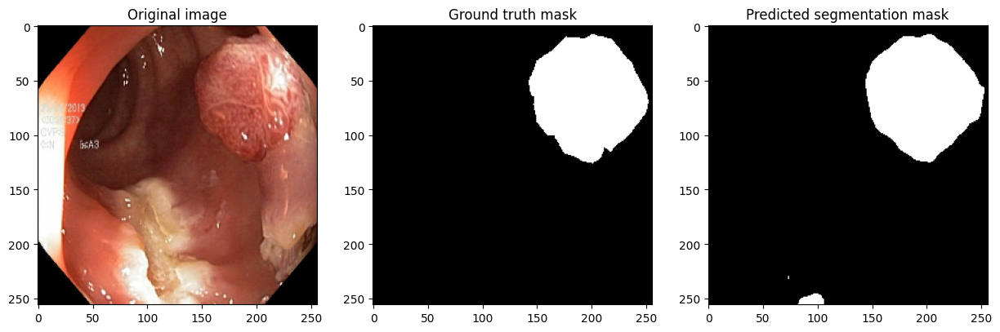

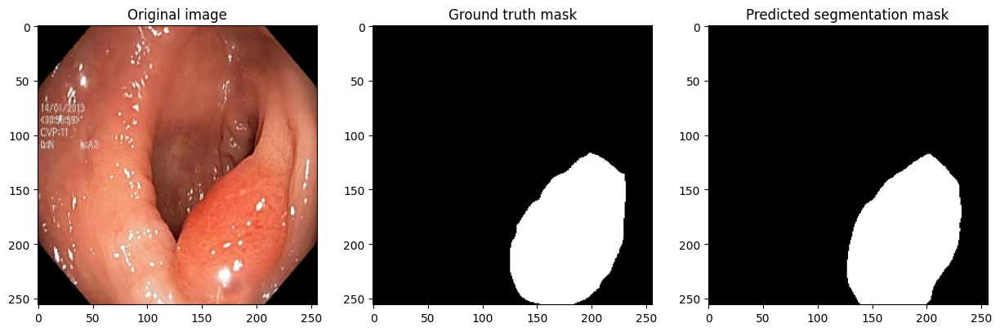

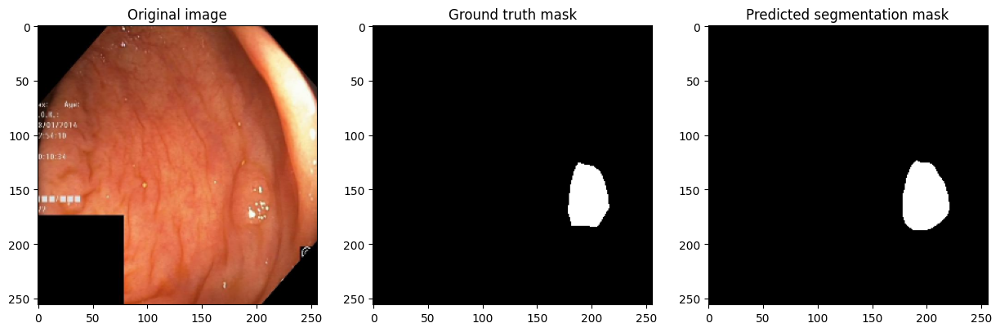

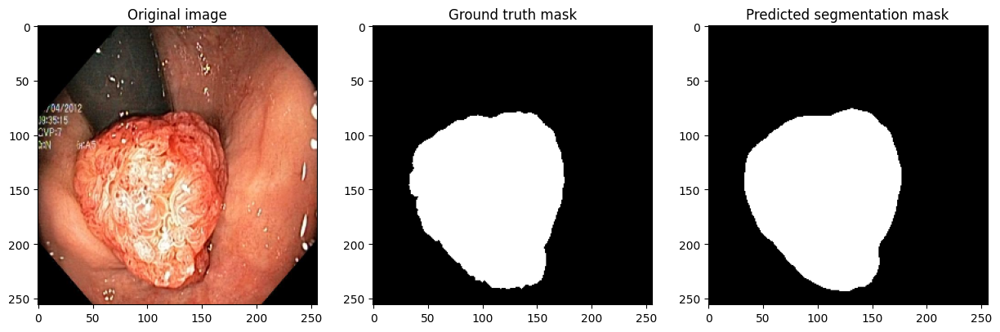

...

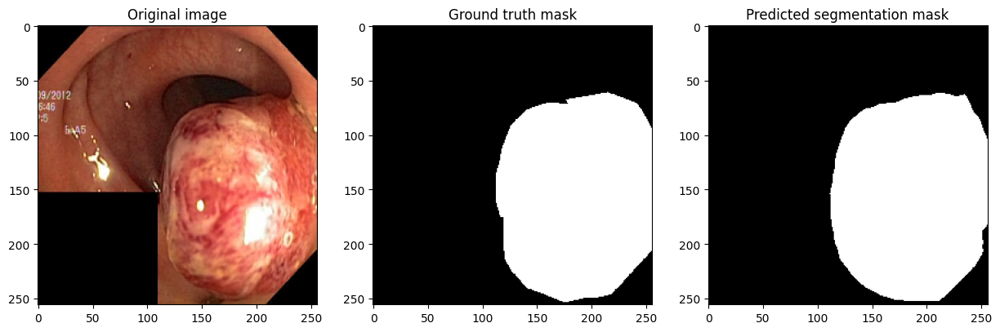

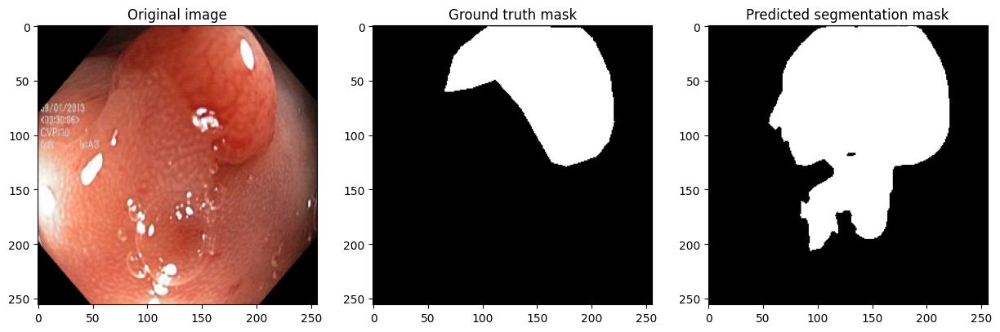

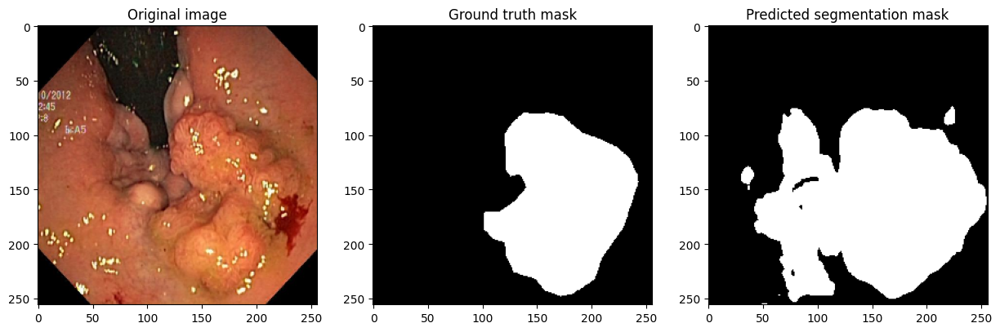

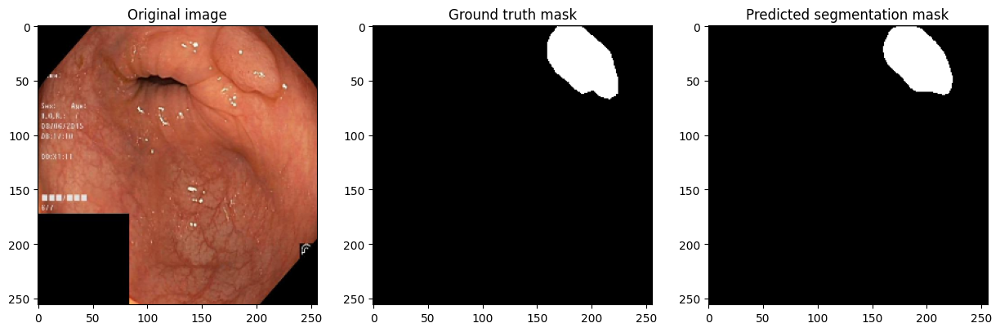

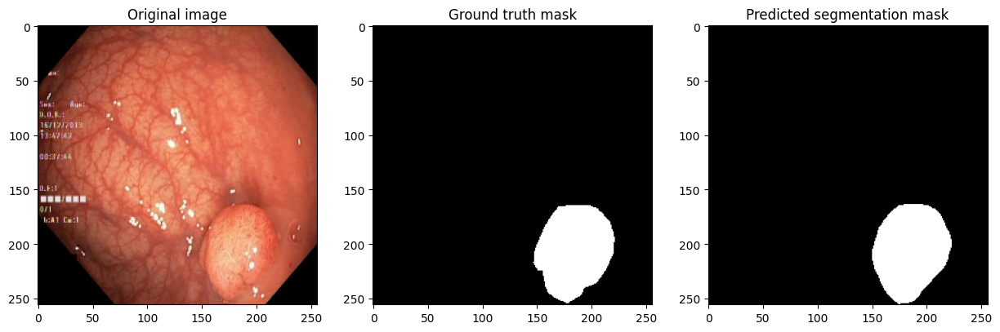

In [16]:
visualize_predictions(model, val_loader, DEVICE, num_samples=50)

In [17]:
# visualize_predictions(model, val_loader, DEVICE, num_samples=100)

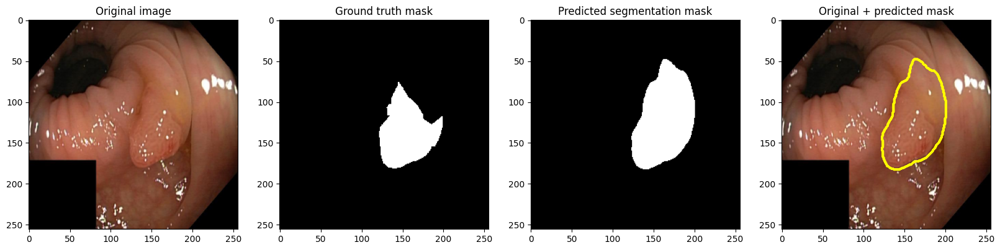

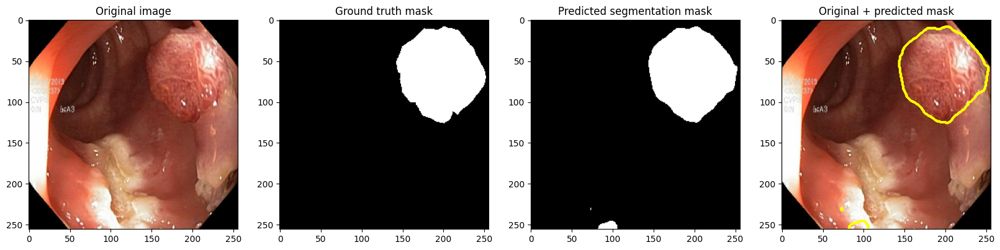

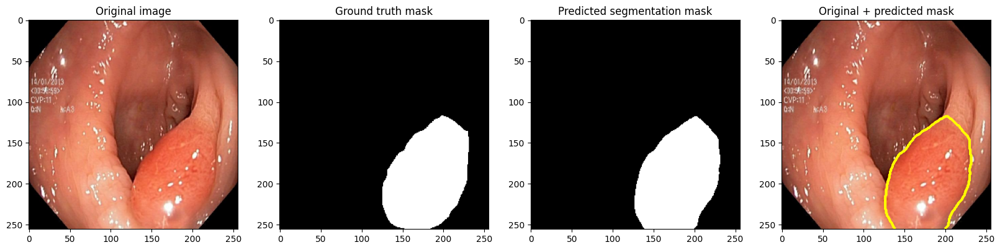

In [18]:
def visualize_predictions(model, val_loader, device, num_samples=3):
    model.eval()
    samples = 0

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(device)
            y = y.to(device).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            for i in range(x.size(0)):
                if samples >= num_samples:
                    break

                plt.figure(figsize=(20, 5))

                plt.subplot(1, 4, 1)
                plt.title("Original image")
                plt.imshow(np.transpose(x[i].cpu().numpy(), (1, 2, 0)))

                plt.subplot(1, 4, 2)
                plt.title("Ground truth mask")
                plt.imshow(y[i].cpu().numpy().squeeze(), cmap="gray")

                plt.subplot(1, 4, 3)
                plt.title("Predicted segmentation mask")
                plt.imshow(preds_binary[i].cpu(
                ).numpy().squeeze(), cmap="gray")

                plt.subplot(1, 4, 4)
                plt.title("Original + predicted mask")
                original_image = np.transpose(x[i].cpu().numpy(), (1, 2, 0))
                plt.imshow(original_image)

                mask = preds_binary[i].cpu().numpy().squeeze()
                mask_border = np.zeros_like(mask)
                mask_border[mask == 1] = 1
                plt.contour(mask_border, colors='yellow', linewidths=2)

                plt.show()
                samples += 1

            if samples >= num_samples:
                break


visualize_predictions(model, val_loader, DEVICE)

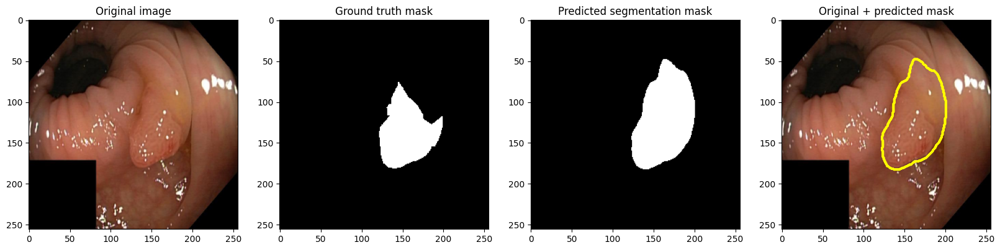

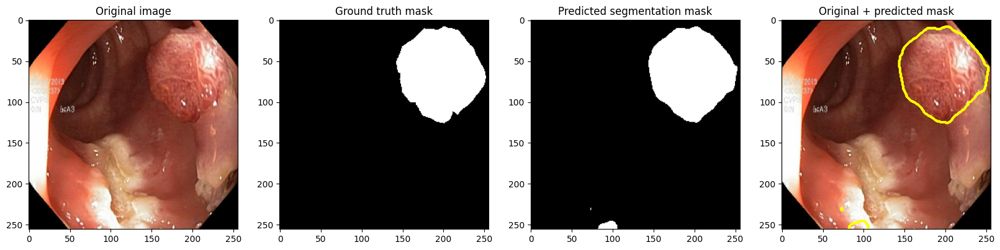

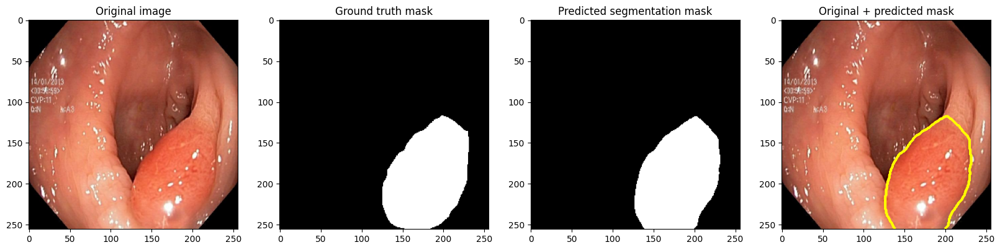

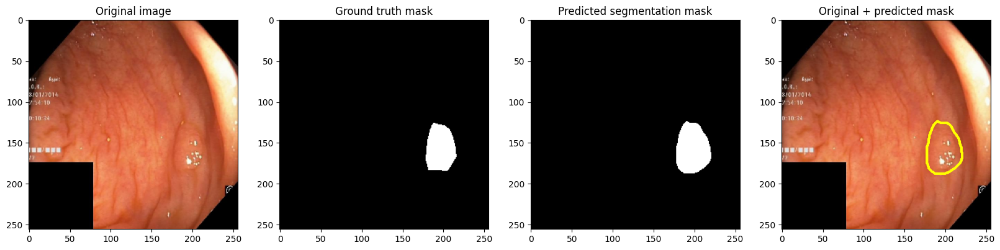

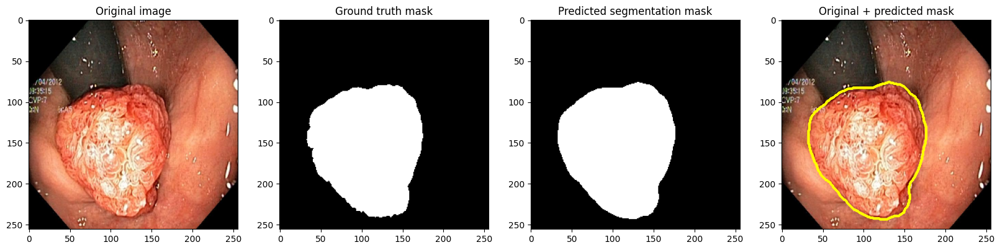

...

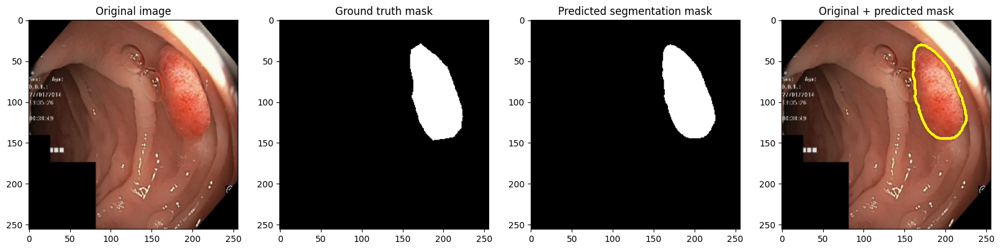

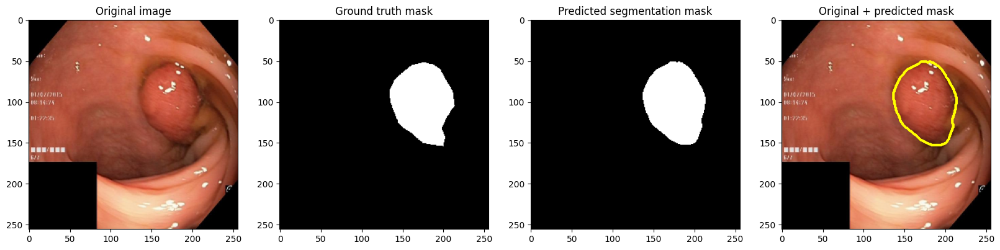

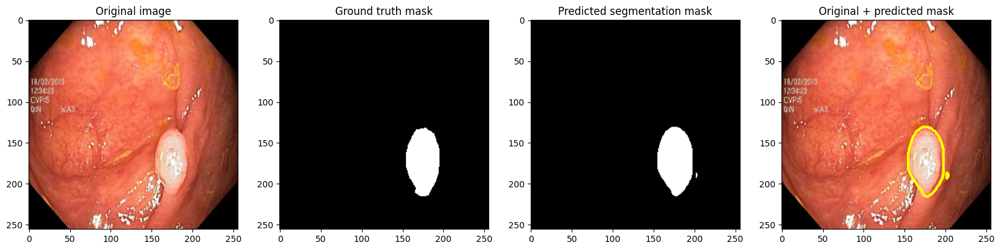

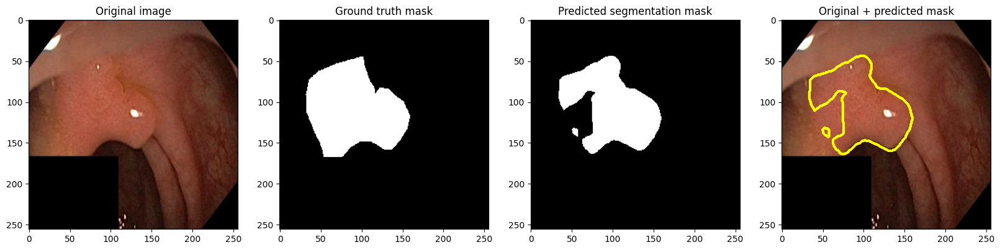

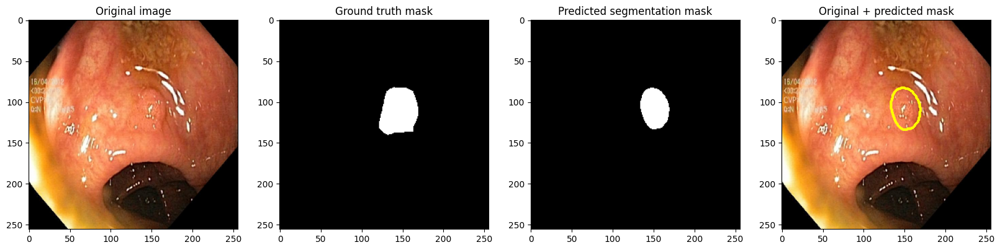

In [19]:
visualize_predictions(model, val_loader, DEVICE, num_samples=100)